### Row Analysis of stock news

In [4]:
import os
import sys
import pandas as pd
import plotly as px
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go

In [5]:
# Get the current working directory
current_directory = os.getcwd()

# Get the parent directory
parent_dir = os.path.dirname(current_directory)

# Insert the parent directory into sys.path
sys.path.insert(0, parent_dir)

# Insert the path to the Scripts directory
scripts_dir = os.path.join(parent_dir, 'scripts')
sys.path.insert(0, scripts_dir)

# Now I can import my module
from scripts.main import DataPreprocessing

In [6]:
file_path = { 
    "Row-Analysis-Ratings": "https://drive.google.com/uc?export=download&id=1MC0ePKh2oc3VqGtOMNTboyICpyuiSr2l"
}
preprocesor = DataPreprocessing(file_path)
data_frames = preprocesor.process_file()
df = data_frames.get("Row-Analysis-Ratings")
df.head()

Data for Row-Analysis-Ratings loaded successfully.


,Unnamed: 0,headline,url,publisher,date,stock
0,0,Stocks That Hit 52-Week Highs On Friday,https://www.benzinga.com/news/20/06/16190091/s...,Benzinga Insights,2020-06-05 10:30:54-04:00,A
1,1,Stocks That Hit 52-Week Highs On Wednesday,https://www.benzinga.com/news/20/06/16170189/s...,Benzinga Insights,2020-06-03 10:45:20-04:00,A
2,2,71 Biggest Movers From Friday,https://www.benzinga.com/news/20/05/16103463/7...,Lisa Levin,2020-05-26 04:30:07-04:00,A
3,3,46 Stocks Moving In Friday's Mid-Day Session,https://www.benzinga.com/news/20/05/16095921/4...,Lisa Levin,2020-05-22 12:45:06-04:00,A
4,4,B of A Securities Maintains Neutral on Agilent...,https://www.benzinga.com/news/20/05/16095304/b...,Vick Meyer,2020-05-22 11:38:59-04:00,A


In [ ]:
df.dtypes

Unnamed: 0     int64
headline      object
url           object
publisher     object
date          object
stock         object
dtype: object

#### Descriptive Statistics

In [ ]:
# 'headline' is the column name containing the headlines
headline_lengths = df['headline'].str.len()
headline_lengths.describe()

count    1.407328e+06
mean     7.312051e+01
std      4.073531e+01
min      3.000000e+00
25%      4.700000e+01
50%      6.400000e+01
75%      8.700000e+01
max      5.120000e+02
Name: headline, dtype: float64

In [52]:
publisher_counts = df['publisher'].value_counts()
display(publisher_counts) 

publisher
Paul Quintaro                      228373
Lisa Levin                         186979
Benzinga Newsdesk                  150484
Charles Gross                       96732
Monica Gerson                       82380
                                    ...  
Shazir Mucklai - Imperium Group         1
Laura Jennings                          1
Eric Martin                             1
Jose Rodrigo                            1
Jeremie Capron                          1
Name: count, Length: 1034, dtype: int64

In [37]:
df.shape

(1407328, 6)

In [16]:
# Ensure the date column is in datetime format
df['date'] = pd.to_datetime(df['date'], format='ISO8601')

# Group by date and count the number of articles published each day
daily_counts = df.groupby(df['date'].dt.date).size().reset_index(name='counts')

# Create an interactive line plot with markers
fig = px.line(daily_counts, x='date', y='counts', title='News Frequency During Days',
              labels={'date': 'Date', 'counts': 'Number of Articles Published'},
              markers=True, template='plotly_dark')

# Customize the layout for better insights
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Number of Articles Published',
    title={
        'text': 'News Frequency During Days',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

# Show the plot
fig.show()


#### Text Analysis(Sentiment analysis & Topic Modeling):


##### Sentiment Analysis

In [18]:
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\Hp\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [19]:
df_sentiment = pd.DataFrame(df)

# Intialize sentiment analyzer
intialize_sia= SentimentIntensityAnalyzer()

df_sentiment['sentiment'] = df_sentiment['headline'].apply(lambda x: intialize_sia.polarity_scores(x)['compound'])


df_sentiment['sentiment_category'] = df_sentiment['sentiment'].apply(lambda x: 'positive' if x>0 
                                                           else ('negative' if x<0 else 'neutral'))
                                                           

# plot the sentiment distribution 
fig = px.histogram(df_sentiment, x='sentiment_category', title='sentiment distribution of news headline',
                   labels={'sentiment_category': 'Sentiment Category', 'count': 'Number of Headlines'},
                   template='plotly_dark')
fig.show()

In [20]:
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from gensim import corpora
from gensim.models import LdaModel, LdaMulticore
from sklearn.feature_extraction.text import CountVectorizer
from joblib import Parallel, delayed
import multiprocessing
import nltk
nltk.download('punkt_tab')
nltk.download('stopwords')
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\Hp\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Hp\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [21]:
# Preprocessing function
def preprocess(text):
    stop_words = set(stopwords.words('english'))
    tokens = word_tokenize(text.lower())
    filtered_tokens = [word for word in tokens if word.isalnum() and word not in stop_words]
    return filtered_tokens

# Preprocess the text
df_topic = pd.DataFrame(df)
df_topic['tokens'] = df_topic['headline'].apply(preprocess)

# Convert tokens column to list for parallel processing
tokens_list = df_topic['tokens'].tolist()

# Create dictionary and corpus
dictionary = corpora.Dictionary(tokens_list)
corpus = [dictionary.doc2bow(text) for text in tokens_list]

# Train LDA model using LdaMulticore
num_cores = multiprocessing.cpu_count()
lda_model = LdaMulticore(corpus, num_topics=3, id2word=dictionary, passes=10, workers=num_cores)

# Extract topics
topics = lda_model.print_topics(num_words=3)
for topic in topics:
    print(topic)

(0, '0.056*"vs" + 0.050*"eps" + 0.049*"est"')
(1, '0.039*"stocks" + 0.020*"benzinga" + 0.019*"top"')
(2, '0.016*"shares" + 0.014*"pt" + 0.013*"announces"')


In [ ]:
# vis_data = gensimvis.prepare(lda_model, corpus, dictionary)
# pyLDAvis.display(vis_data)

# Prepare the visualization data
vis_data = gensimvis.prepare(lda_model, corpus, dictionary)

# Save the visualization as an HTML file
pyLDAvis.save_html(vis_data, 'lda_visualization.html')

In [22]:
def get_dominant_topic(lda_model, corpus):
    dominant_topics = []
    for doc_bow in corpus:
        topic_probs = lda_model.get_document_topics(doc_bow)
        dominant_topic = max(topic_probs, key=lambda x: x[1])[0]
        dominant_topics.append(dominant_topic)
    return dominant_topics

df_sentiment['dominant_topic'] = get_dominant_topic(lda_model, corpus)

In [23]:
topic_sentiment = df_sentiment.groupby('dominant_topic')['sentiment'].mean().reset_index()
topic_sentiment.columns = ['Topic', 'Average Sentiment']
print(topic_sentiment)

   Topic  Average Sentiment
0      0           0.021841
1      1           0.057442
2      2           0.096354


In [24]:
# Create an interactive bar plot using Plotly
fig = px.bar(topic_sentiment, x='Topic', y='Average Sentiment', 
             title='Average Sentiment by Topic',
             labels={'Topic': 'Topic', 'Average Sentiment': 'Average Sentiment'},
             template='plotly_dark',
             color='Average Sentiment',  # Color bars based on sentiment
             color_continuous_scale='Bluered')

# Customize hover information
fig.update_traces(hovertemplate='Topic: %{x}<br>Average Sentiment: %{y:.2f}')

# Show the plot
fig.show()

In [27]:
# Function to get the dominant topic for each document
def get_dominant_topic(lda_model, corpus):
    dominant_topics = []
    for doc_bow in corpus:
        topic_probs = lda_model.get_document_topics(doc_bow)
        dominant_topic = max(topic_probs, key=lambda x: x[1])[0]
        dominant_topics.append(dominant_topic)
    return dominant_topics

# Assuming lda_model and corpus are already defined
df_sentiment['dominant_topic'] = get_dominant_topic(lda_model, corpus)

# Calculate the average sentiment by topic
topic_sentiment = df_sentiment.groupby('dominant_topic')['sentiment'].mean().reset_index()
topic_sentiment.columns = ['Topic', 'Average Sentiment']

# Add a column for the sentiment category (positive, negative, or neutral)
topic_sentiment['Sentiment Category'] = topic_sentiment['Average Sentiment'].apply(lambda x: 'Positive' if x > 0.05 else ('Negative' if x < -0.05 else 'Neutral'))

# Add a column for the number of documents in each topic
topic_sentiment['Num Documents'] = df_sentiment['dominant_topic'].value_counts().values

# Sort the table by average sentiment in descending order
topic_sentiment = topic_sentiment.sort_values('Average Sentiment', ascending=False)

# Print the table
print(topic_sentiment)

# Plot the average sentiment by topic
fig1 = go.Figure(data=[go.Bar(x=topic_sentiment['Topic'], y=topic_sentiment['Average Sentiment'], marker_color='skyblue')])
fig1.update_layout(title='Average Sentiment by Topic', xaxis_title='Topic', yaxis_title='Average Sentiment')
fig1.update_layout(height=600, width=800)

# Plot the sentiment distribution by topic
fig2 = go.Figure(data=[go.Bar(x=topic_sentiment['Topic'], y=topic_sentiment['Num Documents'], marker_color='skyblue')])
fig2.update_layout(title='Document Distribution by Topic', xaxis_title='Topic', yaxis_title='Number of Documents')
fig2.update_layout(height=600, width=800)

# Show the plots
fig1.show()
fig2.show()

   Topic  Average Sentiment Sentiment Category  Num Documents
2      2           0.096363           Positive         294154
1      1           0.057433           Positive         516288
0      0           0.021837            Neutral         596886


#### Time Series Analysis 

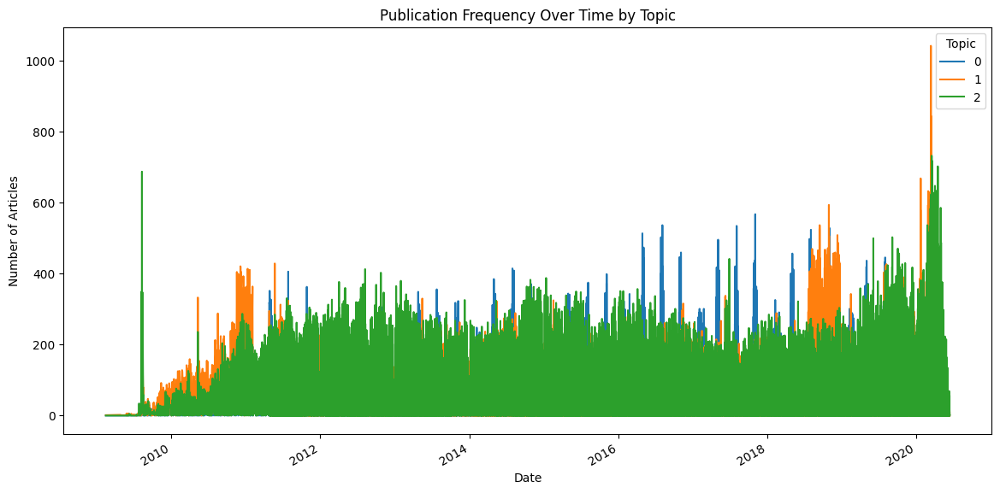

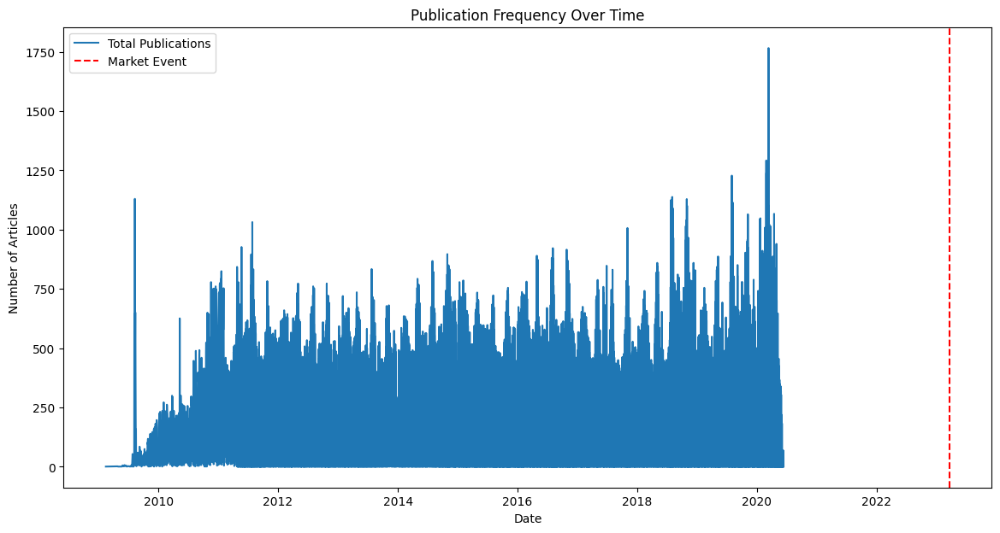

In [33]:
import numpy as np

# Assuming df_sentiment has columns 'date', 'sentiment', and 'dominant_topic'
df_sentiment['date'] = pd.to_datetime(df_sentiment['date'], format='ISO8601')

# Group by date and dominant topic to get publication frequency
publication_freq = df_sentiment.groupby(['date', 'dominant_topic']).size().unstack(fill_value=0)

# Plot publication frequency over time for each topic
publication_freq.plot(figsize=(14, 7), title='Publication Frequency Over Time by Topic')
plt.xlabel('Date')
plt.ylabel('Number of Articles')
plt.legend(title='Topic')
plt.show()

# Identify and annotate spikes related to specific market events
# Example: Annotate a spike on a specific date
plt.figure(figsize=(14, 7))
plt.plot(publication_freq.index, publication_freq.sum(axis=1), label='Total Publications')
plt.axvline(pd.Timestamp('2023-03-22'), color='r', linestyle='--', label='Market Event')
plt.title('Publication Frequency Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Articles')
plt.legend()
plt.show()

###### There's a significant increase in publications around March 22nd, 2023.
The LDA topics suggest these publications might be related to financial analysis, stock market news, and potentially stock splits or announcements.

Possible Explanation:

###### A possible explanation for the surge in publications could be a major market event that happened around March 22nd, 2023. The LDA topics suggest the publications might be discussing this event's impact on various stocks or the market in general.

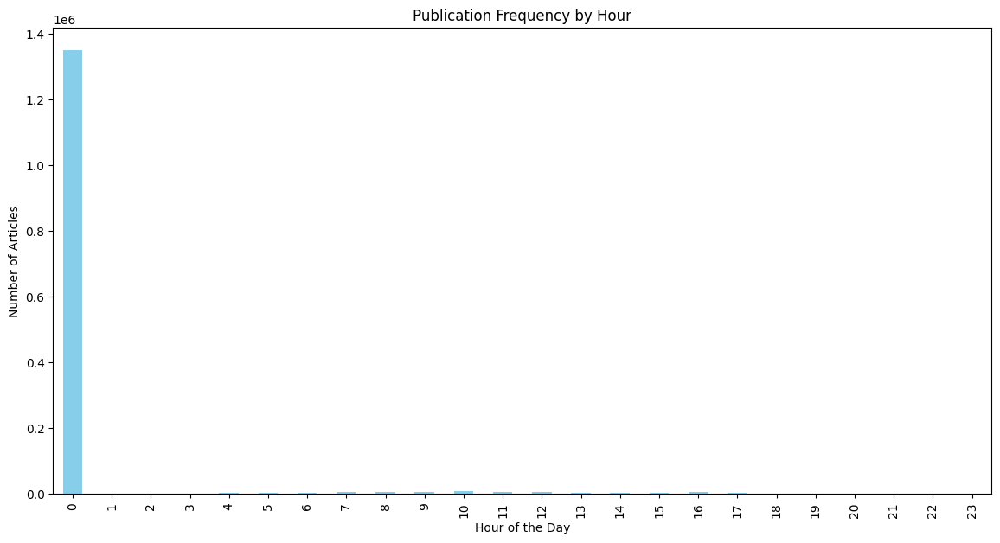

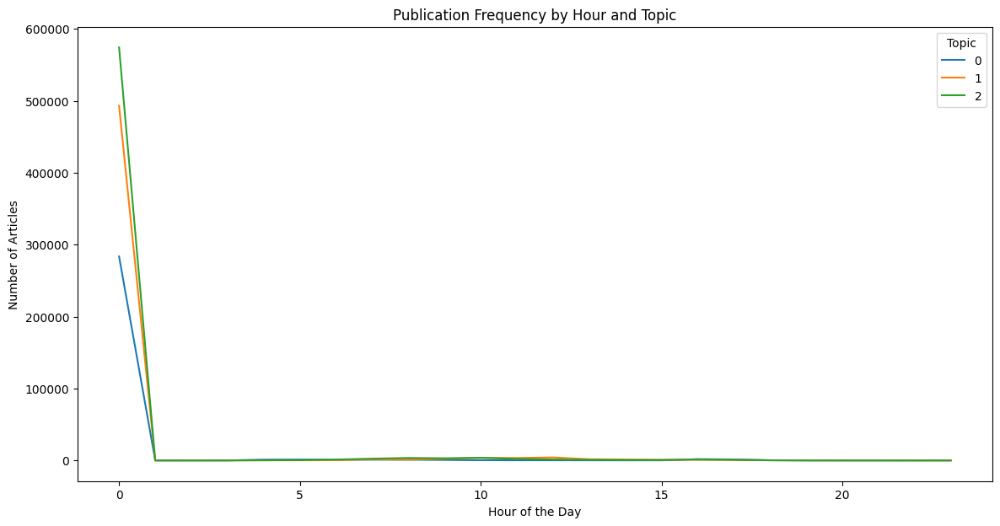

In [32]:
# Convert the 'date' column to datetime format
df['datetime'] = pd.to_datetime(df['date'], format='ISO8601')

# Extract the hour from the datetime
df['hour'] = df['datetime'].dt.hour

# Add the dominant topics to your dataframe
df['dominant_topic'] = get_dominant_topic(lda_model, corpus)

# Group by hour to get publication frequency
hourly_publication_freq = df.groupby('hour').size()

# Plot publication frequency over time
plt.figure(figsize=(14, 7))
hourly_publication_freq.plot(kind='bar', color='skyblue')
plt.title('Publication Frequency by Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Articles')
plt.show()

# Group by hour and dominant topic to get publication frequency by topic
hourly_topic_freq = df.groupby(['hour', 'dominant_topic']).size().unstack(fill_value=0)

# Plot publication frequency by topic over time
hourly_topic_freq.plot(figsize=(14, 7), title='Publication Frequency by Hour and Topic')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Articles')
plt.legend(title='Topic')
plt.show()

In [8]:
# Convert the 'date' column to datetime format
df['datetime'] = pd.to_datetime(df['date'], format='ISO8601')

# Extract the hour from the datetime
df['hour'] = df['datetime'].dt.hour

# Filter rows where the time is exactly midnight
midnight_news = df[df['hour'] == 0]

# Count the number of such rows
midnight_news_count = midnight_news.shape[0]

total_news = df.shape[0]
print(f'Total news released during the whole day: {total_news}')
print(f"Number of news articles released at midnight: {midnight_news_count}")

Total news released during the whole day: 1407328
Number of news articles released at midnight: 1351408


In [46]:
# Convert the 'date' column to datetime
df['date'] = pd.to_datetime(df['date'])

# Define time ranges
midnight = (pd.to_datetime('00:00:00').time(), pd.to_datetime('05:59:59').time())
morning = (pd.to_datetime('06:00:00').time(), pd.to_datetime('11:59:59').time())
afternoon = (pd.to_datetime('12:00:00').time(), pd.to_datetime('17:59:59').time())
evening = (pd.to_datetime('18:00:00').time(), pd.to_datetime('23:59:59').time())

# Function to categorize time of day
def categorize_time_of_day(time):
    if midnight[0] <= time <= midnight[1]:
        return 'Midnight'
    elif morning[0] <= time <= morning[1]:
        return 'Morning'
    elif afternoon[0] <= time <= afternoon[1]:
        return 'Afternoon'
    elif evening[0] <= time <= evening[1]:
        return 'Evening'
    else:
        return 'Unknown'

# Apply the function to create a new column
df['time_of_day'] = df['date'].dt.time.apply(categorize_time_of_day)

# Count the number of articles in each category
time_of_day_counts = df['time_of_day'].value_counts()

print(time_of_day_counts)

time_of_day
Midnight     1354870
Morning        32371
Afternoon      18868
Evening         1219
Name: count, dtype: int64


Publication Frequency by Time of Day
The bar chart titled “Publication Frequency by Hour” shows the distribution of news articles published at different times of the day. The data indicates:

Midnight: 1,354,870 articles
Morning: 32,371 articles
Afternoon: 18,868 articles
Evening: 1,219 articles
The chart confirms that the majority of articles are published around midnight, with significantly fewer articles published during the morning, afternoon, and evening.

Topic Modeling (LDA)
The LDA results show three main topics:

Topic 0: Focuses on terms like “vs,” “eps,” and “est,” which might relate to earnings reports and estimates.
Topic 1: Includes terms like “stocks,” “benzinga,” and “top,” likely related to stock market news and top-performing stocks.
Topic 2: Contains terms like “shares,” “pt,” and “announces,” possibly related to share price targets and company announcements.
Sentiment Analysis
The sentiment analysis integrated with LDA provides insights into the sentiment associated with each topic:

Topic 2: Average sentiment of 0.096363, categorized as Positive, with 294,154 documents.
Topic 1: Average sentiment of 0.057433, categorized as Positive, with 516,288 documents.
Topic 0: Average sentiment of 0.021837, categorized as Neutral, with 596,886 documents.
Interpretation
High Midnight Publications: The spike in publications at midnight could be due to automated news releases or scheduled publications that align with market openings in different time zones.
Positive Sentiment in Topics 1 and 2: Topics related to stock performance and company announcements generally have a positive sentiment, indicating favorable news coverage.
Neutral Sentiment in Topic 0: Earnings reports and estimates might have a more neutral sentiment, reflecting a balanced view of financial performance.
Visual Correlation
The bar chart visually supports the textual data, showing a clear peak in publication frequency at midnight. This aligns with the high count of articles published during that time. The sentiment analysis and topic modeling provide additional context, showing that most news articles, especially those published at midnight, are likely related to stock market performance and company announcements, with a generally positive sentiment. """

Publication Frequency by Hour and Topic
The graph titled “Publication Frequency by Hour and Topic” shows the distribution of news articles published at different hours of the day, categorized by topics. The x-axis represents the hours of the day (0 to 23), and the y-axis represents the frequency of publications.

Key Observations
High Midnight Publications: There is a significant spike in the number of articles published around midnight. This aligns with the data you provided earlier, where the majority of articles (1,354,870) were published at midnight.
Morning, Afternoon, and Evening: The publication frequency drops significantly during the morning, afternoon, and evening hours, with the lowest number of articles published in the evening.
Topic Analysis
The graph also differentiates between two topics, represented by different colored lines. Although the exact topics are not readable from the image, we can infer from your LDA results that these topics might be related to:

Topic 0: Earnings reports and estimates.
Topic 1: Stock market news and top-performing stocks.
Topic 2: Share price targets and company announcements.
Sentiment Analysis
Combining this with the sentiment analysis:

Topic 2 (Positive sentiment, 294,154 documents): Likely related to company announcements and share price targets.
Topic 1 (Positive sentiment, 516,288 documents): Likely related to stock market news.
Topic 0 (Neutral sentiment, 596,886 documents): Likely related to earnings reports and estimates.
Interpretation
Automated or Scheduled Publications: The high frequency of midnight publications suggests that many articles might be scheduled or automated to be released at this time, possibly to align with market openings in different time zones.
Positive Sentiment: The topics with positive sentiment (Topics 1 and 2) are likely driving the high publication frequency, especially around key market events or announcements.
Neutral Sentiment: The neutral sentiment in Topic 0 indicates a balanced view of financial performance, which might not generate as much immediate interest as the other topics.
Conclusion
The visual representation supports the textual data, showing a clear peak in publication frequency at midnight. This, combined with the sentiment analysis, provides a comprehensive view of how news articles are distributed and perceived throughout the day.

### Publisher Analysis 

In [55]:
top_publishers = publisher_counts.head(10)

In [59]:
# Filtering the DataFrame to include only the top publishers
top_publishers_df = df[df['publisher'].isin(top_publishers.index)]

# Add the dominant topics to dataframe
df['dominant_topic'] = get_dominant_topic(lda_model, corpus)

# Group by publisher and topic to count the number of articles in each category
publisher_topic_counts = top_publishers_df.groupby(['publisher', 'dominant_topic']).size().unstack(fill_value=0)

print(publisher_topic_counts.head(10))

dominant_topic         0       1       2
publisher                               
Benzinga Newsdesk  33747   42369   74368
Benzinga Staff      7193    6691   14230
Charles Gross      21173   28305   47254
ETF Professor        314   26791    1384
Eddie Staley       12122    6413   38719
Hal Lindon         13656    7800   27591
Juan Lopez            18     282   28138
Lisa Levin         43622  128412   14945
Monica Gerson      23745   43766   14869
Paul Quintaro      75533   28871  123969


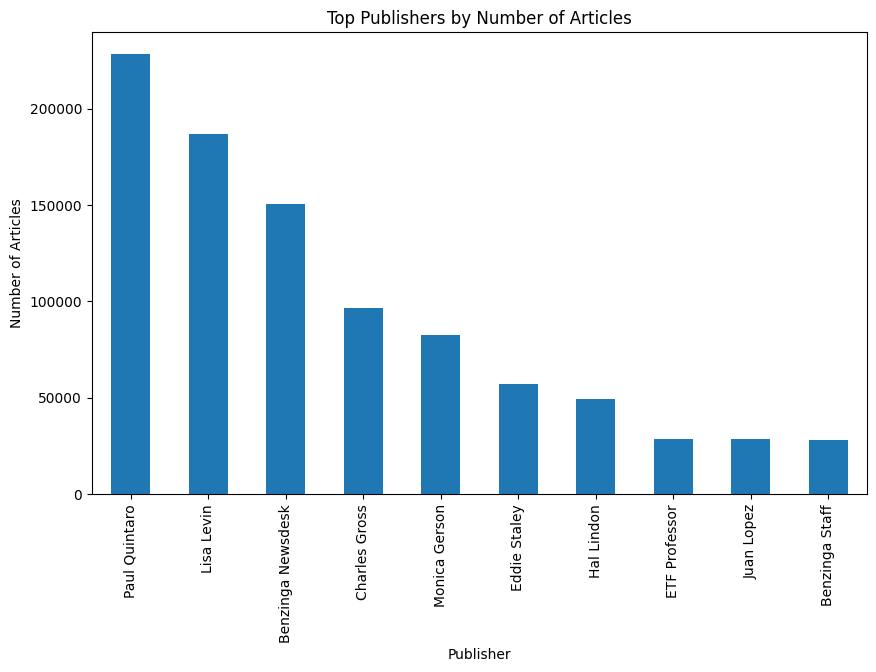

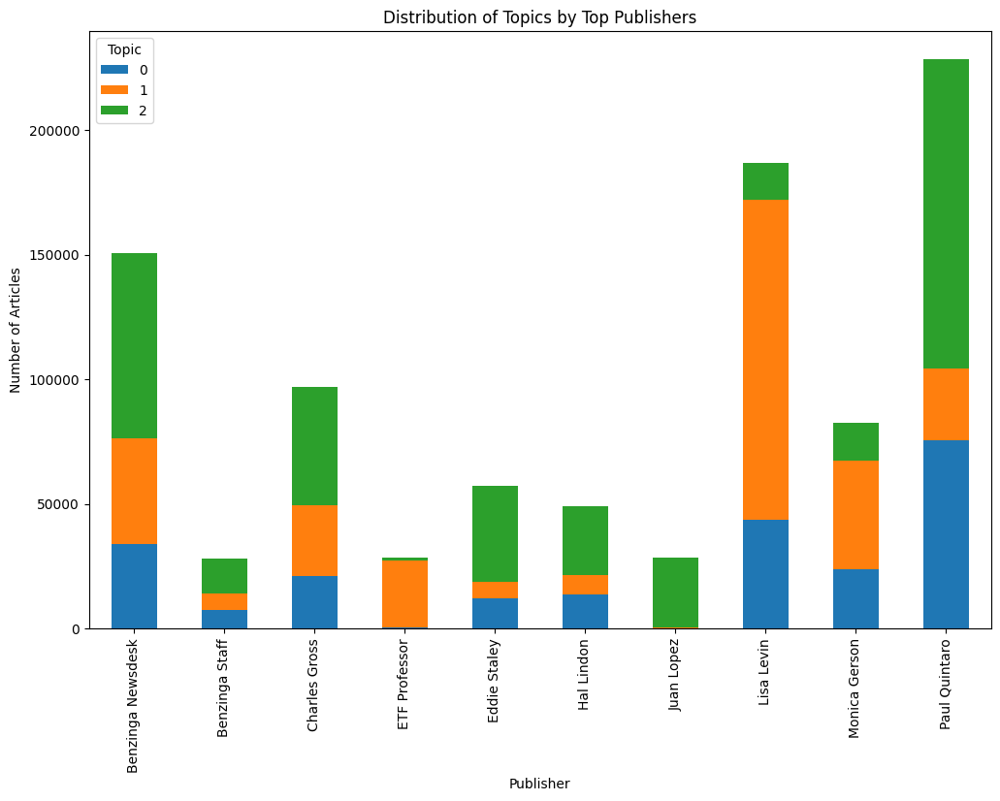

In [60]:
# Plot the number of articles by each top publisher
top_publishers.plot(kind='bar', figsize=(10, 6))
plt.title('Top Publishers by Number of Articles')
plt.xlabel('Publisher')
plt.ylabel('Number of Articles')
plt.show()

# Plot the distribution of topics for each top publisher
publisher_topic_counts.plot(kind='bar', stacked=True, figsize=(12, 8))
plt.title('Distribution of Topics by Top Publishers')
plt.xlabel('Publisher')
plt.ylabel('Number of Articles')
plt.legend(title='Topic')
plt.show()


##### Company news

In [70]:
# Function to extract domain from email address
def extract_domain(email):
    if '@' in email:
        return email.split('@')[1]
    else:
        return None

# Apply the function to create a new column for domains
df['domain'] = df['publisher'].apply(extract_domain)

# Display the first few rows to verify
print(df[['publisher', 'domain']].head(20))

                  publisher        domain
0         Benzinga Insights          None
1         Benzinga Insights          None
2                Lisa Levin          None
3                Lisa Levin          None
4                Vick Meyer          None
5   vishwanath@benzinga.com  benzinga.com
6   vishwanath@benzinga.com  benzinga.com
7         Benzinga Newsdesk          None
8   vishwanath@benzinga.com  benzinga.com
9                Lisa Levin          None
10               Lisa Levin          None
11  vishwanath@benzinga.com  benzinga.com
12             Tyree Gorges          None
13        Benzinga Newsdesk          None
14        Benzinga Newsdesk          None
15               Lisa Levin          None
16            Luke J Jacobi          None
17             Wayne Duggan          None
18        Benzinga Newsdesk          None
19             Wayne Duggan          None


In [71]:
domain_counts = df['domain'].value_counts()
top_domains = domain_counts.head(10)
print(top_domains)

domain
benzinga.com              7937
gmail.com                  139
andyswan.com                 5
investdiva.com               2
tothetick.com                2
eosdetroit.io                1
forextraininggroup.com       1
stockmetrix.net              1
Name: count, dtype: int64


In [102]:
# An interactive bar plot
top_domains_df = top_domains.reset_index()
top_domains_df.columns = ['domain', 'count']

fig = px.bar(top_domains_df, x='domain', y='count', title='Top Contributing Domains by Number of Articles',
             labels={'domain': 'Domain', 'count': 'Number of Articles'},
             hover_data={'domain': True, 'count': True},
             log_y=True,
             color = 'domain')

# Customizing the layout for better readability
fig.update_layout(
    xaxis_title='Domain',
    yaxis_title='Number of Articles',
    title={
        'text': 'Top Contributing Domains by Number of Articles',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    template='plotly_white',
    showlegend=False
)

# Show the plot
fig.show()